Github Link: https://github.com/Hirak010/Real-time-surveillance-detection

## Summary

There is a critical need for an automated surveillance solution that can continuously and accurately monitor environments for signs of emergencies, providing real-time alerts to facilitate rapid intervention.
Traditional systems relying on human operators are often slow and prone to errors, which can result in severe consequences, including loss of life and extensive propertydamage.
Our project aims to develop a real-time emergency surveillance system that leverages computer vision to detect and respond to critical situations such as fires, violence, and medical emergencies.

## Imports

In [ ]:
import os
import math
import random
import shutil
import threading
import time
from collections import deque
from base64 import b64encode

import cv2
import numpy as np
import mediapipe as mp
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.utils import to_categorical, plot_model

from keras.models import load_model, save_model, Sequential
from keras.callbacks import EarlyStopping
from keras.layers import *
from keras.applications.mobilenet_v2 import MobileNetV2

from PIL import Image, ImageTk
import tkinter as tk
from tkinter import ttk

import telebot
from IPython.display import HTML

# Ensure unique imports
plt.style.use("seaborn")

In [87]:
def Play_Video(filepath):
    html = ''
    video = open(filepath, 'rb').read()
    src = 'data:video/mp4;base64,' + b64encode(video).decode()
    html += '<video width=640 muted controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
    return HTML(html)

In [61]:
os.getcwd()

'D:\\Projects\\Real_Time_Violence_Detection_System'

In [89]:
# Classes Directories
NonViolnceVideos_Dir = "D:\\Projects\\Real_Time_Violence_Detection_System\\Real Life Violence Dataset\\NonViolence"
ViolnceVideos_Dir = "D:\\Projects\\Real_Time_Violence_Detection_System\\Real Life Violence Dataset\\Violence"

# Retrieve the list of all the video files present in the Class Directory.
NonViolence_files_names_list = os.listdir(NonViolnceVideos_Dir)
Violence_files_names_list = os.listdir(ViolnceVideos_Dir)

# Randomly select a video file from the Classes Directory.
Random_NonViolence_Video = random.choice(NonViolence_files_names_list)
Random_Violence_Video = random.choice(Violence_files_names_list)

In [91]:
Play_Video(f"{ViolnceVideos_Dir}/{Random_Violence_Video}")

## Extracting Frames

In [92]:
# Specify the height and width to which each video frame will be resized in our dataset.
IMAGE_HEIGHT , IMAGE_WIDTH = 64, 64
 
# Specify the number of frames of a video that will be fed to the model as one sequence.
SEQUENCE_LENGTH = 16
 

DATASET_DIR = "D:\Projects\Real_Time_Violence_Detection_System\Real Life VIolence Situation Dataset\Real Life Violence Dataset"
 
CLASSES_LIST = ["NonViolence","Violence"]

In [63]:
def frames_extraction(video_path):
 
    frames_list = []
    
    # Read the Video File
    video_reader = cv2.VideoCapture(video_path)
 
    # Get the total number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
 
    # Calculate the the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH), 1)
 
    # Iterate through the Video Frames.
    for frame_counter in range(SEQUENCE_LENGTH):
 
        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
 
        # Reading the frame from the video. 
        success, frame = video_reader.read()
        
        if not success:
            break
 
        # Resize the Frame to fixed height and width.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the resized frame
        normalized_frame = resized_frame / 255
        
        # Append the normalized frame into the frames list
        frames_list.append(normalized_frame)
    
 
    video_reader.release()
 
    return frames_list

In [64]:
def create_dataset():
 
    features = []
    labels = []
    video_files_paths = []
    
    # Iterating through all the classes.
    for class_index, class_name in enumerate(CLASSES_LIST):
        
        print(f'Extracting Data of Class: {class_name}')
        
        # Get the list of video files present in the specific class name directory.
        files_list = os.listdir(os.path.join(DATASET_DIR, class_name))
        
        # Iterate through all the files present in the files list.
        for file_name in files_list:
            
            # Get the complete video path.
            video_file_path = os.path.join(DATASET_DIR, class_name, file_name)
 
            # Extract the frames of the video file.
            frames = frames_extraction(video_file_path)
 
            # Check if the extracted frames are equal to the SEQUENCE_LENGTH specified.
            # So ignore the vides having frames less than the SEQUENCE_LENGTH.
            if len(frames) == SEQUENCE_LENGTH:
 
                # Append the data to their repective lists.
                features.append(frames)
                labels.append(class_index)
                video_files_paths.append(video_file_path)
 
    features = np.asarray(features)
    labels = np.array(labels)  

    return features, labels, video_files_paths

In [28]:
# Create the dataset.
features, labels, video_files_paths = create_dataset()

Extracting Data of Class: NonViolence
Extracting Data of Class: Violence


In [29]:
# Saving the extracted data
np.save("features.npy",features)
np.save("labels.npy",labels)
np.save("video_files_paths.npy",video_files_paths)

In [93]:
features, labels, video_files_paths = np.load("features.npy") , np.load("labels.npy") ,  np.load("video_files_paths.npy")

In [66]:
features

array([[[[[0.51764706, 0.49411765, 0.45882353],
          [0.51372549, 0.49803922, 0.4627451 ],
          [0.54509804, 0.54117647, 0.50196078],
          ...,
          [0.47843137, 0.49803922, 0.50980392],
          [0.46666667, 0.48627451, 0.49803922],
          [0.4627451 , 0.48627451, 0.49019608]],

         [[0.52941176, 0.50588235, 0.47058824],
          [0.50980392, 0.49411765, 0.45882353],
          [0.58431373, 0.57254902, 0.52941176],
          ...,
          [0.3372549 , 0.35686275, 0.36862745],
          [0.43137255, 0.44705882, 0.47058824],
          [0.44705882, 0.4745098 , 0.48627451]],

         [[0.53333333, 0.51372549, 0.47058824],
          [0.52941176, 0.50980392, 0.46666667],
          [0.51764706, 0.50588235, 0.4627451 ],
          ...,
          [0.41568627, 0.44313725, 0.46666667],
          [0.37647059, 0.40392157, 0.43137255],
          [0.3254902 , 0.35686275, 0.36862745]],

         ...,

         [[0.68627451, 0.69019608, 0.62745098],
          [0.68235294,

## One Hot Encoding

In [67]:
# convert labels into one-hot-encoded vectors
one_hot_encoded_labels = to_categorical(labels)

## Train Test Split

In [68]:
# Split the Data into Train ( 90% ) and Test Set ( 10% ).
features_train, features_test, labels_train, labels_test = train_test_split(features, one_hot_encoded_labels, test_size = 0.1,
                                                                            shuffle = True, random_state = 42)

In [69]:
print(features_train.shape,labels_train.shape )
print(features_test.shape, labels_test.shape)

(1800, 16, 64, 64, 3) (1800, 2)
(200, 16, 64, 64, 3) (200, 2)


In [36]:
mobilenet = MobileNetV2( include_top=False , weights="imagenet")

#Fine-Tuning to make the last 40 layer trainable
mobilenet.trainable=True

for layer in mobilenet.layers[:-40]:
  layer.trainable=False


9406464/9406464 [==============================] - 2s 0us/step


In [37]:
mobilenet.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, None, None, 32)       128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, None, None, 32)       0         ['bn_Conv1[

 block_3_expand_relu (ReLU)  (None, None, None, 144)      0         ['block_3_expand_BN[0][0]']   
                                                                                                  
 block_3_pad (ZeroPadding2D  (None, None, None, 144)      0         ['block_3_expand_relu[0][0]'] 
 )                                                                                                
                                                                                                  
 block_3_depthwise (Depthwi  (None, None, None, 144)      1296      ['block_3_pad[0][0]']         
 seConv2D)                                                                                        
                                                                                                  
 block_3_depthwise_BN (Batc  (None, None, None, 144)      576       ['block_3_depthwise[0][0]']   
 hNormalization)                                                                                  
          

 block_6_depthwise_BN (Batc  (None, None, None, 192)      768       ['block_6_depthwise[0][0]']   
 hNormalization)                                                                                  
                                                                                                  
 block_6_depthwise_relu (Re  (None, None, None, 192)      0         ['block_6_depthwise_BN[0][0]']
 LU)                                                                                              
                                                                                                  
 block_6_project (Conv2D)    (None, None, None, 64)       12288     ['block_6_depthwise_relu[0][0]
                                                                    ']                            
                                                                                                  
 block_6_project_BN (BatchN  (None, None, None, 64)       256       ['block_6_project[0][0]']     
 ormalizat

                                                                                                  
 block_9_add (Add)           (None, None, None, 64)       0         ['block_8_add[0][0]',         
                                                                     'block_9_project_BN[0][0]']  
                                                                                                  
 block_10_expand (Conv2D)    (None, None, None, 384)      24576     ['block_9_add[0][0]']         
                                                                                                  
 block_10_expand_BN (BatchN  (None, None, None, 384)      1536      ['block_10_expand[0][0]']     
 ormalization)                                                                                    
                                                                                                  
 block_10_expand_relu (ReLU  (None, None, None, 384)      0         ['block_10_expand_BN[0][0]']  
 )        

                                                                                                  
 block_13_expand_relu (ReLU  (None, None, None, 576)      0         ['block_13_expand_BN[0][0]']  
 )                                                                                                
                                                                                                  
 block_13_pad (ZeroPadding2  (None, None, None, 576)      0         ['block_13_expand_relu[0][0]']
 D)                                                                                               
                                                                                                  
 block_13_depthwise (Depthw  (None, None, None, 576)      5184      ['block_13_pad[0][0]']        
 iseConv2D)                                                                                       
                                                                                                  
 block_13_

 iseConv2D)                                                                                       
                                                                                                  
 block_16_depthwise_BN (Bat  (None, None, None, 960)      3840      ['block_16_depthwise[0][0]']  
 chNormalization)                                                                                 
                                                                                                  
 block_16_depthwise_relu (R  (None, None, None, 960)      0         ['block_16_depthwise_BN[0][0]'
 eLU)                                                               ]                             
                                                                                                  
 block_16_project (Conv2D)   (None, None, None, 320)      307200    ['block_16_depthwise_relu[0][0
                                                                    ]']                           
          

## Building the Model

In [38]:
def create_model():
 
    model = Sequential()

    ########################################################################################################################
    
    #Specifying Input to match features shape
    model.add(Input(shape = (SEQUENCE_LENGTH, IMAGE_HEIGHT, IMAGE_WIDTH, 3)))
    
    # Passing mobilenet in the TimeDistributed layer to handle the sequence
    model.add(TimeDistributed(mobilenet))
    
    model.add(Dropout(0.25))
                                    
    model.add(TimeDistributed(Flatten()))

    lstm_fw = LSTM(units=32)
    lstm_bw = LSTM(units=32, go_backwards = True)  

    model.add(Bidirectional(lstm_fw, backward_layer = lstm_bw))
    
    model.add(Dropout(0.25))

    model.add(Dense(256,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(128,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(64,activation='relu'))
    model.add(Dropout(0.25))

    model.add(Dense(32,activation='relu'))
    model.add(Dropout(0.25))
    
    
    model.add(Dense(len(CLASSES_LIST), activation = 'softmax'))
 
    ########################################################################################################################

    model.summary()
    
    return model

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 time_distributed (TimeDist  (None, 16, 2, 2, 1280)    2257984   
 ributed)                                                        
                                                                 
 dropout (Dropout)           (None, 16, 2, 2, 1280)    0         
                                                                 
 time_distributed_1 (TimeDi  (None, 16, 5120)          0         
 stributed)                                                      
                                                                 
 bidirectional (Bidirection  (None, 64)                1319168   
 al)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                        

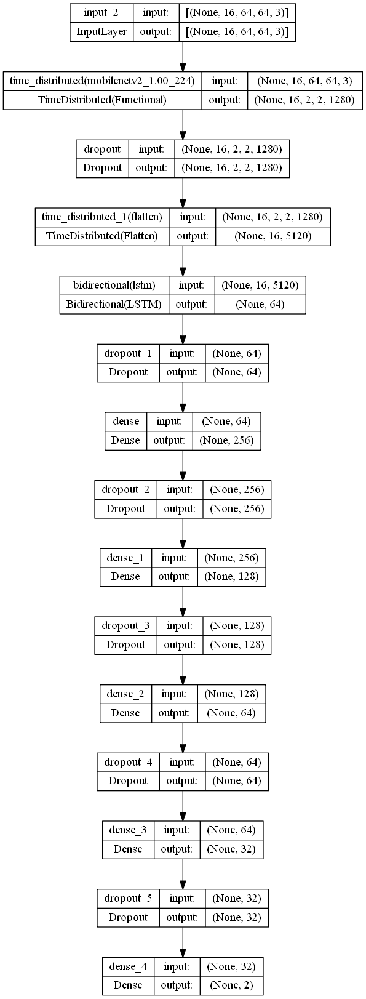

In [39]:
# Constructing the Model
MoBiLSTM_model = create_model()

# Plot the structure of the contructed LRCN model.
plot_model(MoBiLSTM_model, to_file = 'MobBiLSTM_model_structure_plot.png', show_shapes = True, show_layer_names = True)

## Fitting and Callbacks

In [40]:
# Create Early Stopping Callback to monitor the accuracy
early_stopping_callback = EarlyStopping(monitor = 'val_accuracy', patience = 10, restore_best_weights = True)

# Create ReduceLROnPlateau Callback to reduce overfitting by decreasing learning
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss',
                                                  factor=0.6,
                                                  patience=5,
                                                  min_lr=0.00005,
                                                  verbose=1)
 
# Compiling the model 
MoBiLSTM_model.compile(loss = 'categorical_crossentropy', optimizer = 'sgd', metrics = ["accuracy"])
 
# Fitting the model 
MobBiLSTM_model_history = MoBiLSTM_model.fit(x = features_train, y = labels_train, epochs = 50, batch_size = 8 ,
                                             shuffle = True, validation_split = 0.2, callbacks = [early_stopping_callback,reduce_lr])

Epoch 1/50
180/180 [==============================] - 109s 555ms/step - loss: 0.6960 - accuracy: 0.5264 - val_loss: 0.6862 - val_accuracy: 0.5861 - lr: 0.0100
Epoch 2/50
180/180 [==============================] - 100s 558ms/step - loss: 0.6830 - accuracy: 0.5514 - val_loss: 0.6723 - val_accuracy: 0.6194 - lr: 0.0100
Epoch 3/50
180/180 [==============================] - 99s 553ms/step - loss: 0.6565 - accuracy: 0.6056 - val_loss: 0.5836 - val_accuracy: 0.7778 - lr: 0.0100
Epoch 4/50
180/180 [==============================] - 101s 559ms/step - loss: 0.5051 - accuracy: 0.7729 - val_loss: 0.5744 - val_accuracy: 0.7861 - lr: 0.0100
Epoch 5/50
180/180 [==============================] - 97s 540ms/step - loss: 0.4230 - accuracy: 0.8215 - val_loss: 0.3003 - val_accuracy: 0.8889 - lr: 0.0100
Epoch 6/50
180/180 [==============================] - 97s 537ms/step - loss: 0.3388 - accuracy: 0.8708 - val_loss: 0.4083 - val_accuracy: 0.8528 - lr: 0.0100
Epoch 7/50
180/180 [=============================

In [41]:
model_evaluation_history = MoBiLSTM_model.evaluate(features_test, labels_test)

7/7 [==============================] - 7s 607ms/step - loss: 0.2004 - accuracy: 0.9250


## Model Evaluation

In [42]:
def plot_metric(model_training_history, metric_name_1, metric_name_2, plot_name):
    
    metric_value_1 = model_training_history.history[metric_name_1]
    metric_value_2 = model_training_history.history[metric_name_2]
    
    # Get the Epochs Count
    epochs = range(len(metric_value_1))
 
    plt.plot(epochs, metric_value_1, 'blue', label = metric_name_1)
    plt.plot(epochs, metric_value_2, 'orange', label = metric_name_2)
 
    plt.title(str(plot_name))
 
    plt.legend()

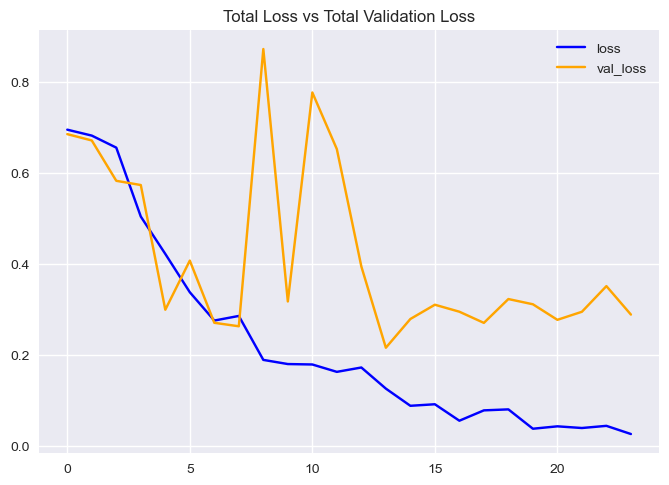

In [43]:
plot_metric(MobBiLSTM_model_history, 'loss', 'val_loss', 'Total Loss vs Total Validation Loss')

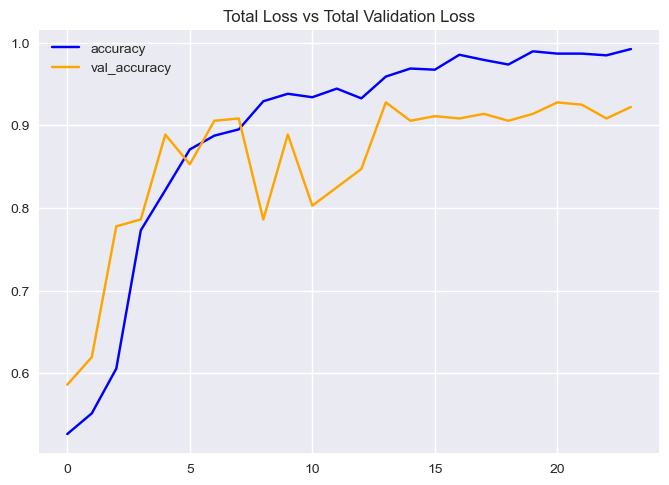

In [44]:
plot_metric(MobBiLSTM_model_history, 'accuracy', 'val_accuracy', 'Total Loss vs Total Validation Loss')

## Predicting the test set

In [70]:
labels_predict = MoBiLSTM_model.predict(features_test)

7/7 [==============================] - 6s 607ms/step


In [71]:
# Decoding the data to use in Metrics
labels_predict = np.argmax(labels_predict , axis=1)
labels_test_normal = np.argmax(labels_test , axis=1)

In [72]:
labels_test_normal.shape , labels_predict.shape

((200,), (200,))

### Accuracy

In [73]:
AccScore = accuracy_score(labels_predict, labels_test_normal)
print('Accuracy Score is : ', AccScore)

Accuracy Score is :  0.925


### Confusion Matrix

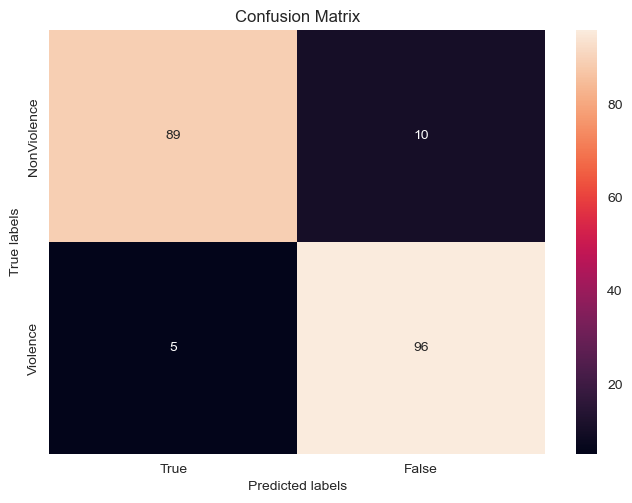

In [49]:
ax= plt.subplot()
cm=confusion_matrix(labels_test_normal, labels_predict)
sns.heatmap(cm, annot=True, fmt='g', ax=ax);  

ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['True', 'False']); ax.yaxis.set_ticklabels(['NonViolence', 'Violence']);


### Classification Report

In [50]:

ClassificationReport = classification_report(labels_test_normal,labels_predict)
print('Classification Report is : \n', ClassificationReport)

Classification Report is : 
               precision    recall  f1-score   support

           0       0.95      0.90      0.92        99
           1       0.91      0.95      0.93       101

    accuracy                           0.93       200
   macro avg       0.93      0.92      0.92       200
weighted avg       0.93      0.93      0.92       200



## Save the Model

In [74]:
# Assuming MoBiLSTM_model is your model
MoBiLSTM_model.save("MoBiLSTM_model.h5")


C:\Users\asus\anaconda3\lib\site-packages\keras\src\engine\training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


## Load the Model

In [75]:
MoBiLSTM_model = load_model("MoBiLSTM_model.h5")


## Predicting Frame by Frame

In [76]:
def predict_frames(video_file_path, output_file_path, SEQUENCE_LENGTH):
    
    # Read from the video file.
    video_reader = cv2.VideoCapture(video_file_path)
 
    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
 
    # VideoWriter to store the output video in the disk.
    video_writer = cv2.VideoWriter(output_file_path, cv2.VideoWriter_fourcc('m', 'p', '4', 'v'), 
                                    video_reader.get(cv2.CAP_PROP_FPS), (original_video_width, original_video_height))
 
    # Declare a queue to store video frames.
    frames_queue = deque(maxlen = SEQUENCE_LENGTH)
 
    # Store the predicted class in the video.
    predicted_class_name = ''
    
    # Iterate until the video is accessed successfully.
    while video_reader.isOpened():
 
        ok, frame = video_reader.read() 
        
        if not ok:
            break
 
        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the resized frame 
        normalized_frame = resized_frame / 255
 
        # Appending the pre-processed frame into the frames list.
        frames_queue.append(normalized_frame)
 
        # We Need at Least number of SEQUENCE_LENGTH Frames to perform a prediction.
        # Check if the number of frames in the queue are equal to the fixed sequence length.
        if len(frames_queue) == SEQUENCE_LENGTH:
            # Pass the normalized frames to the model and get the predicted probabilities.
            predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_queue, axis = 0))[0]
 
            # Get the index of class with highest probability.
            predicted_label = np.argmax(predicted_labels_probabilities)
 
            # Get the class name using the retrieved index.
            predicted_class_name = CLASSES_LIST[predicted_label]
 
        # Write predicted class name on top of the frame.
        if predicted_class_name == "Violence":
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 255), 12)
        else:
            cv2.putText(frame, predicted_class_name, (5, 100), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 255, 0), 12)
         
        # Write The frame into the disk using the VideoWriter
        video_writer.write(frame)
  
    video_reader.release()
    video_writer.release()

In [77]:
plt.style.use("default")

# To show Random Frames from the saved output predicted video (output predicted video doesn't show on the notebook but can be downloaded)
def show_pred_frames(pred_video_path): 

    plt.figure(figsize=(20,15))

    video_reader = cv2.VideoCapture(pred_video_path)

    # Get the number of frames in the video.
    frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Get Random Frames from the video then Sort it
    random_range = sorted(random.sample(range (SEQUENCE_LENGTH , frames_count ), 12))
        
    for counter, random_index in enumerate(random_range, 1):
        
        plt.subplot(5, 4, counter)

        # Set the current frame position of the video.  
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, random_index)
          
        ok, frame = video_reader.read() 

        if not ok:
          break 

        frame = cv2.cvtColor(frame , cv2.COLOR_BGR2RGB)

        plt.imshow(frame)
        plt.axis('off')  # Turn off axis
        plt.tight_layout() 
                            
    video_reader.release()

In [78]:
# Construct the output video path.
test_videos_directory = 'test_videos'
os.makedirs(test_videos_directory, exist_ok = True)
 
output_video_file_path = f'{test_videos_directory}/Output-Test-Video.mp4'

1/1 [==============================] - 0s 78ms/step


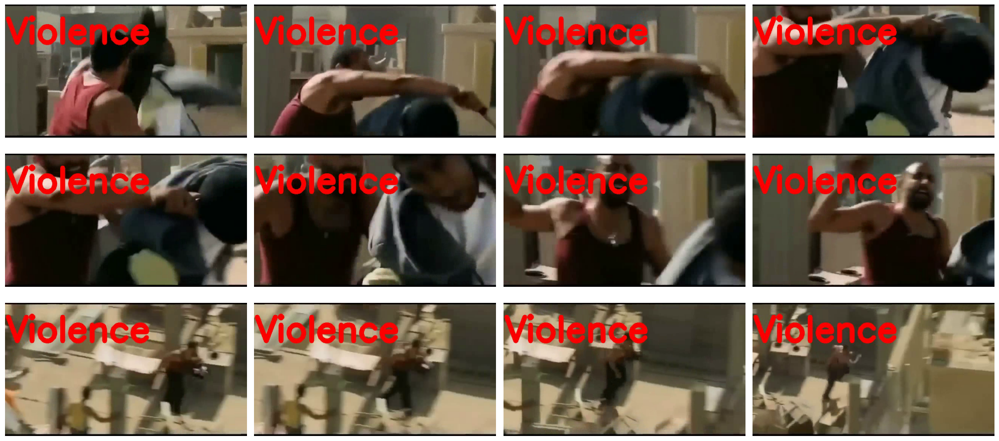

In [79]:
# Specifying video to be predicted
input_video_file_path = "D:\\Projects\\Real_Time_Violence_Detection_System\\Real Life VIolence Situation Dataset\\Real Life Violence Dataset\\Violence\\V_378.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

In [80]:
# Play the actual video
Play_Video(input_video_file_path)

1/1 [==============================] - 0s 68ms/step


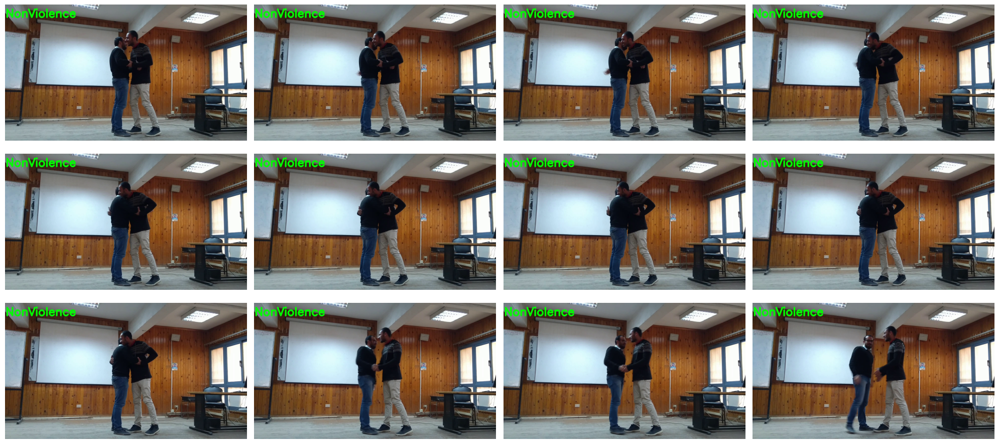

In [81]:
# Specifying video to be predicted
input_video_file_path = "D:\\Projects\\Real_Time_Violence_Detection_System\\Real Life VIolence Situation Dataset\\Real Life Violence Dataset\\NonViolence\\NV_1.mp4"

# Perform Prediction on the Test Video.
predict_frames(input_video_file_path, output_video_file_path, SEQUENCE_LENGTH)

# Show random frames from the output video
show_pred_frames(output_video_file_path)

In [41]:
# Play the actual video
Play_Video(input_video_file_path)

## Prediction for the Video

In [94]:
def predict_video(video_file_path, SEQUENCE_LENGTH):
 
    video_reader = cv2.VideoCapture(video_file_path)
 
    # Get the width and height of the video.
    original_video_width = int(video_reader.get(cv2.CAP_PROP_FRAME_WIDTH))
    original_video_height = int(video_reader.get(cv2.CAP_PROP_FRAME_HEIGHT))
 
    # Declare a list to store video frames we will extract.
    frames_list = []
    
    # Store the predicted class in the video.
    predicted_class_name = ''
 
    # Get the number of frames in the video.
    video_frames_count = int(video_reader.get(cv2.CAP_PROP_FRAME_COUNT))
 
    # Calculate the interval after which frames will be added to the list.
    skip_frames_window = max(int(video_frames_count/SEQUENCE_LENGTH),1)
 
    # Iterating the number of times equal to the fixed length of sequence.
    for frame_counter in range(SEQUENCE_LENGTH):
 
        # Set the current frame position of the video.
        video_reader.set(cv2.CAP_PROP_POS_FRAMES, frame_counter * skip_frames_window)
 
        success, frame = video_reader.read() 
 
        if not success:
            break
 
        # Resize the Frame to fixed Dimensions.
        resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
        
        # Normalize the resized frame.
        normalized_frame = resized_frame / 255
        
        # Appending the pre-processed frame into the frames list
        frames_list.append(normalized_frame)
        
        
    # Passing the  pre-processed frames to the model and get the predicted probabilities.
    predicted_labels_probabilities = MoBiLSTM_model.predict(np.expand_dims(frames_list, axis = 0))[0]
 
    # Get the index of class with highest probability.
    predicted_label = np.argmax(predicted_labels_probabilities)
 
    # Get the class name using the retrieved index.
    predicted_class_name = CLASSES_LIST[predicted_label]
    
    # Display the predicted class along with the prediction confidence.
    print(f'Predicted: {predicted_class_name}\nConfidence: {predicted_labels_probabilities[predicted_label]}')
        
    video_reader.release()

In [95]:
# Specifying video to be predicted
input_video_file_path = "D:\\Projects\\Real_Time_Violence_Detection_System\\Real Life VIolence Situation Dataset\\Real Life Violence Dataset\\Violence\\V_274.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, SEQUENCE_LENGTH)

# Play the actual video
Play_Video(input_video_file_path)

1/1 [==============================] - 0s 294ms/step
Predicted: Violence
Confidence: 0.988959789276123


In [96]:
# Specifying video to be predicted
input_video_file_path = "D:\\Projects\\Real_Time_Violence_Detection_System\\Real Life VIolence Situation Dataset\\Real Life Violence Dataset\\NonViolence\\NV_194.mp4"

# Perform Single Prediction on the Test Video.
predict_video(input_video_file_path, SEQUENCE_LENGTH)

# Play the actual video
Play_Video(input_video_file_path)

1/1 [==============================] - 0s 76ms/step
Predicted: NonViolence
Confidence: 0.9993643164634705


## Fall & Fall Detection 

**Note:** We are using a pretrained model for fire detection. We imported it from a xml file `fire_detection_cascade_model.xml`

In [ ]:
mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose

def calculate_angle(a, b, c):
    a = np.array(a)  # First
    b = np.array(b)  # Mid
    c = np.array(c)  # End
    
    radians = np.arctan2(c[1]-b[1], c[0]-b[0]) - np.arctan2(a[1]-b[1], a[0]-b[0])
    angle = np.abs(radians*180.0/np.pi)
    
    if angle > 180.0:
        angle = 360-angle
        
    return int(angle)

def detect_fall(frame, pose):
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    image.flags.writeable = False
    results = pose.process(image)
    image.flags.writeable = True
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    
    if not results.pose_landmarks:
        return image, None, None

    image_height, image_width, _ = image.shape
    landmarks = results.pose_landmarks.landmark

    # Extract relevant landmarks
    nose = [int(landmarks[mp_pose.PoseLandmark.NOSE].x * image_width),
            int(landmarks[mp_pose.PoseLandmark.NOSE].y * image_height)]
    left_heel = [int(landmarks[mp_pose.PoseLandmark.LEFT_HEEL].x * image_width),
                 int(landmarks[mp_pose.PoseLandmark.LEFT_HEEL].y * image_height)]
    right_heel = [int(landmarks[mp_pose.PoseLandmark.RIGHT_HEEL].x * image_width),
                  int(landmarks[mp_pose.PoseLandmark.RIGHT_HEEL].y * image_height)]

    # Calculate the midpoint between heels
    heel_midpoint = [(left_heel[0] + right_heel[0]) // 2, (left_heel[1] + right_heel[1]) // 2]

    # Calculate the fall distance
    fall_distance = heel_midpoint[0] - nose[0]

    # Determine if falling or standing
    falling = abs(fall_distance) > 50
    standing = abs(fall_distance) <= 50

    # Draw landmarks
    mp_drawing.draw_landmarks(
        image, results.pose_landmarks, mp_pose.POSE_CONNECTIONS,
        mp_drawing.DrawingSpec(color=(255,255,255), thickness=2, circle_radius=2), 
        mp_drawing.DrawingSpec(color=(0,0,0), thickness=2, circle_radius=2) 
    )

    return image, falling, standing



#### Main script for integrating everything along with the alert system.

In [ ]:

# Load the pre-trained violence detection model
MoBiLSTM_model = load_model("MoBiLSTM_model.h5")

# Constants for violence detection
IMAGE_HEIGHT, IMAGE_WIDTH = 64, 64
SEQUENCE_LENGTH = 16
CLASSES_LIST = ["NonViolence", "Violence"]

# Load the fire detection cascade model
xml_path = 'fire_detection_cascade_model.xml'
fire_cascade = cv2.CascadeClassifier(xml_path)


# Initialize the Telegram bot
bot = telebot.TeleBot("7223589660:AAEmG9nlq8eCLKoGcB0sW_Y9BHJsfBM-sMw")
CHAT_ID = "5286247538"

# Time of the last alert
last_alert_time = 0

class IntegratedSafetyMonitoringApp:
    def __init__(self, window, window_title):
        self.window = window
        self.window.title(window_title)

        self.video_source = 0
        self.vid = cv2.VideoCapture(self.video_source)

        self.canvas = tk.Canvas(window, width=self.vid.get(cv2.CAP_PROP_FRAME_WIDTH), height=self.vid.get(cv2.CAP_PROP_FRAME_HEIGHT))
        self.canvas.pack()

        self.btn_quit = ttk.Button(window, text="Quit", command=self.quit)
        self.btn_quit.pack(anchor=tk.SE, padx=10, pady=10)

        # Create a frame for the bottom labels
        self.bottom_frame = tk.Frame(self.window)
        self.bottom_frame.pack(side=tk.BOTTOM, fill=tk.X)

        # Labels for fall, violence, and fire detection results
        self.fall_label = ttk.Label(self.bottom_frame, text="Status: Standing | Falls: 0", font=("Helvetica", 12))
        self.fall_label.pack(side=tk.LEFT, padx=10)

        self.violence_label = ttk.Label(self.bottom_frame, text="Violence: NonViolence", font=("Helvetica", 12))
        self.violence_label.pack(side=tk.LEFT, padx=10)

        self.fire_label = ttk.Label(self.bottom_frame, text="Fire: Not Detected", font=("Helvetica", 12))
        self.fire_label.pack(side=tk.LEFT, padx=10)

        self.pose = mp.solutions.pose.Pose(min_detection_confidence=0.5, min_tracking_confidence=0.5)

        self.fall_count = 0
        self.fall_status = "Standing"
        self.frames_buffer = []

        self.delay = 15
        self.update()

        # Start the Telegram bot in a separate thread
        self.stop_bot = False
        self.bot_thread = threading.Thread(target=self.run_telegram_bot)
        self.bot_thread.start()

        self.window.protocol("WM_DELETE_WINDOW", self.on_closing)
        self.window.mainloop()

    def update(self):
        ret, frame = self.vid.read()

        if ret:
            # Fall detection
            frame, falling, standing = detect_fall(frame, self.pose)

            if falling:
                self.fall_status = "Falling"
                self.send_telegram_alert(frame, "Fall detected!")
            elif standing and self.fall_status == "Falling":
                self.fall_status = "Standing"
                self.fall_count += 1

            self.fall_label.config(text=f"Status: {self.fall_status} | Falls: {self.fall_count}")

            # Violence detection
            resized_frame = cv2.resize(frame, (IMAGE_HEIGHT, IMAGE_WIDTH))
            normalized_frame = resized_frame / 255.0
            self.frames_buffer.append(normalized_frame)
            if len(self.frames_buffer) > SEQUENCE_LENGTH:
                self.frames_buffer.pop(0)

            violence_prediction = "NonViolence"
            violence_prob = 0

            if len(self.frames_buffer) == SEQUENCE_LENGTH:
                violence_prediction, violence_prob = self.predict_violence(np.array([self.frames_buffer]))

            self.update_violence_label(violence_prediction, violence_prob)

            if violence_prediction == "Violence":
                self.send_telegram_alert(frame, "Violence detected!")

            # Fire detection
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            fires = fire_cascade.detectMultiScale(gray, 1.2, 5)
            fire_detected = len(fires) > 0
            fire_prob = min(len(fires) / 10.0, 1.0) if fire_detected else 0

            self.update_fire_label(fire_detected, fire_prob)

            if fire_detected:
                for (x, y, w, h) in fires:
                    cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
                    cv2.putText(frame, 'Fire', (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)
                self.send_telegram_alert(frame, "Fire detected!")

            # Display the frame
            self.photo = ImageTk.PhotoImage(image=Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)))
            self.canvas.create_image(0, 0, image=self.photo, anchor=tk.NW)

        self.window.after(self.delay, self.update)

    def predict_violence(self, sequence):
        predicted_labels_probabilities = MoBiLSTM_model.predict(sequence)[0]
        predicted_label = np.argmax(predicted_labels_probabilities)
        predicted_class_name = CLASSES_LIST[predicted_label]
        return predicted_class_name, predicted_labels_probabilities[predicted_label]

    def update_violence_label(self, prediction, probability):
        text = f"Violence: {prediction} ({probability:.2f})"
        color = 'red' if prediction == "Violence" else 'green'
        self.violence_label.config(text=text, foreground=color)

    def update_fire_label(self, detected, probability):
        text = f"Fire: {'Detected' if detected else 'Not Detected'} ({probability:.2f})"
        color = 'red' if detected else 'green'
        self.fire_label.config(text=text, foreground=color)

    def send_telegram_alert(self, frame, message):
        global last_alert_time
        current_time = time.time()
        
        if current_time - last_alert_time >= 60:
            try:
                cv2.imwrite("alert.jpg", frame)
                with open("alert.jpg", 'rb') as photo:
                    bot.send_photo(CHAT_ID, photo, caption=f"🚨 ALERT! 🚨\n{message}")
                bot.send_message(CHAT_ID, f"{message} Please take necessary precautions immediately!")
                last_alert_time = current_time
                print(f"Telegram alert sent: {message}")
            except Exception as e:
                print(f"Error sending Telegram alert: {e}")
        else:
            print("Waiting to send next alert. Time since last alert:", int(current_time - last_alert_time), "seconds")

    def run_telegram_bot(self):
        @bot.message_handler(commands=['start'])
        def handle_start(message):
            bot.reply_to(message, "Integrated Safety Monitoring system is running. Use /stop to terminate the system.")

        @bot.message_handler(commands=['stop'])
        def handle_stop(message):
            bot.reply_to(message, "Stopping the Integrated Safety Monitoring system...")
            self.stop_bot = True
            self.window.quit()

        while not self.stop_bot:
            try:
                bot.polling(none_stop=True, timeout=1)
            except Exception as e:
                print(f"An error occurred with the Telegram bot: {e}")
                time.sleep(5)

    def quit(self):
        self.stop_bot = True
        self.vid.release()
        self.window.quit()

    def on_closing(self):
        self.quit()

if __name__ == "__main__":
    IntegratedSafetyMonitoringApp(tk.Tk(), "Real Time Video Surveillance and Triggering System")